In [24]:
!nvidia-smi

Sun Dec 24 18:43:32 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.12             Driver Version: 535.104.12   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1080 Ti     On  | 00000000:06:00.0 Off |                  N/A |
| 35%   47C    P8              17W / 250W |  10671MiB / 11264MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
import tensorflow as tf
print(tf.__version__)

2023-12-24 18:14:32.003701: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-24 18:14:32.003726: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-24 18:14:32.004752: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-24 18:14:32.011236: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-24 18:14:32.975216: W tensorflow/compiler/tf2

2.15.0


In [2]:
!pip install tf-explain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 109.7 kB/s eta 0:00:00a 0:00:01


In [3]:
# Common
import os 
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from IPython.display import clear_output as cls

# Data 
from tqdm import tqdm
import tensorflow.data as tfd

# Data Visualization
import matplotlib.pyplot as plt

# Model Building
from tensorflow.keras import layers
from tensorflow.keras import callbacks
from tensorflow.keras import optimizers
from tensorflow.keras import metrics
from tensorflow.keras.optimizers.schedules import ExponentialDecay

# Model visualization
from tensorflow.keras.utils import plot_model
from tf_explain.core.grad_cam import GradCAM

# Extra
from typing import List, Tuple, Union

In [36]:
# Image and Mask Dimensions
IMAGE_HEIGHT = 160
IMAGE_WIDTH = 160
N_IMAGE_CHANNELS = 3
N_MASK_CHANNELS = 1

# Image and Mask Size
IMAGE_SIZE = (IMAGE_WIDTH, IMAGE_HEIGHT, N_IMAGE_CHANNELS)
MASK_SIZE = (IMAGE_WIDTH, IMAGE_HEIGHT, N_MASK_CHANNELS)

# Batch Size and Learning Rate
BATCH_SIZE = 32
BASE_LR = 1e-2

# Model Name
MODEL_NAME = 'UNetForestSegmentation'

# Model Training
EPOCHS = 10

# Data Paths
ROOT_IMAGE_DIR = 'input/Forest Segmented/Forest Segmented/images/'
ROOT_MASK_DIR = 'input/Forest Segmented/Forest Segmented/masks/'
METADATA_CSV_PATH = 'input/meta_data.csv'

# Model Architecture
FILTERS = 32

In [5]:
# Random Seed
SEED = 42

np.random.seed(SEED)
tf.random.set_seed(SEED)

Now we can shift our focus to loading the forest area segmentation data into memory. For this purpose, we will be creating 2 utility functions that will load the data for us. These functions will help us to load the forest images and their respective masks and create a TensorFlow data set that we can use for training our model.

In [6]:
def load_image_and_mask(image_path: str, mask_path: str) -> Tuple[tf.Tensor, tf.Tensor]:
    
    '''
    This function takes the file paths of an image and its corresponding mask as input. It first reads the images, then decodes them into tensors, 
    and resizes them to a standard size. After that, the image and mask tensors are normalized by clipping the pixel values between 0 and 1. 
    Finally, the function converts the image and mask tensors to the float32 data type and returns them as a tuple.
    
    Arguments : 
        image_path : The path to the image to be loaded. 
        mask_path  : The path to the mask to be loaded.
    
    Returns :
        image : This is the loaded and the processed image. 
        mask  : This is the loaded and the processed mask.
    
    '''
    
    # Read the images
    image = tf.io.read_file(filename = image_path)
    mask  = tf.io.read_file(filename = mask_path)
    
    # Decode the images
    image = tf.image.decode_jpeg(contents = image, channels = N_IMAGE_CHANNELS)
    mask  = tf.image.decode_jpeg(contents = mask,  channels = N_MASK_CHANNELS)
    
    # Convert the image to a Tensor
    image = tf.image.convert_image_dtype(image = image, dtype = tf.float32)
    mask  = tf.image.convert_image_dtype(image = mask, dtype = tf.float32)
    
    # Resize the image to the desired dimensions
    image = tf.image.resize(images = image, size = (IMAGE_WIDTH, IMAGE_HEIGHT))
    mask  = tf.image.resize(images = mask, size = (IMAGE_WIDTH, IMAGE_HEIGHT))
    
    # Normalize the image
    image = tf.clip_by_value(image, clip_value_min = 0.0, clip_value_max = 1.0)
    mask  = tf.clip_by_value(mask, clip_value_min = 0.0, clip_value_max = 1.0)
    
    # Final conversion
    image = tf.cast(image, dtype = tf.float32)
    mask  = tf.cast(mask,  dtype = tf.float32)
    
    return image, mask

In [10]:
!pwd

/home/jinda/Downloads/vision


In [15]:
# Load CSV File
metadata = pd.read_csv(METADATA_CSV_PATH)

# Quick look
metadata.head()

,image,mask
0,10452_sat_08.jpg,10452_mask_08.jpg
1,10452_sat_18.jpg,10452_mask_18.jpg
2,111335_sat_00.jpg,111335_mask_00.jpg
3,111335_sat_01.jpg,111335_mask_01.jpg
4,111335_sat_02.jpg,111335_mask_02.jpg


In [17]:
# Add root path to image file names
metadata['image'] = [os.path.join(ROOT_IMAGE_DIR,filename) for filename in metadata['image']]

# Add mask path to image file names
metadata['mask']  = [os.path.join(ROOT_MASK_DIR,filename) for filename in metadata['mask']]

# Quick Check
metadata.head()

,image,mask
0,input/Forest Segmented/Forest Segmented/images...,input/Forest Segmented/Forest Segmented/masks/...
1,input/Forest Segmented/Forest Segmented/images...,input/Forest Segmented/Forest Segmented/masks/...
2,input/Forest Segmented/Forest Segmented/images...,input/Forest Segmented/Forest Segmented/masks/...
3,input/Forest Segmented/Forest Segmented/images...,input/Forest Segmented/Forest Segmented/masks/...
4,input/Forest Segmented/Forest Segmented/images...,input/Forest Segmented/Forest Segmented/masks/...


In [19]:
def load_dataset(
    image_paths: list, mask_paths: list, split_ratio: float=0.2, 
    batch_size: int=BATCH_SIZE, shuffle: bool=True, 
    buffer_size: int=1000, n_repeat: int=1
) -> Union[Tuple[tfd.Dataset, tfd.Dataset], tfd.Dataset]:
    '''
    This function loads the image and mask data from the provided file paths and creates a TensorFlow dataset. The function
    first creates space to store the image and mask data in numpy arrays. It then iterates over each image and mask pair, 
    loading them using the load_image_and_mask function and storing them in the numpy arrays.
    
    The function then creates a TensorFlow dataset using the numpy arrays. If shuffle is True, it shuffles the dataset
    with a buffer size of buffer_size. If split_ratio is not None, it splits the dataset into two parts with sizes determined
    by the split_ratio, and converts them into batches of size batch_size with drop_remainder=True. The two resulting datasets
    are returned as a tuple.

    If split_ratio is None, the entire dataset is converted into batches of size batch_size with drop_remainder=True, 
    and the resulting dataset is returned.
    
    Args:
        image_paths: A list of strings, containing the file paths of the input images.
        
        mask_paths: A list of strings, containing the file paths of the corresponding mask images.
        
        split_ratio: A float value between 0 and 1, representing the ratio of data to be used for validation. 
                    If split_ratio is set to None, then no data will be split for validation.
                    
        batch_size: An integer, representing the batch size for the input data.
        
        shuffle: A boolean value indicating whether the data should be shuffled or not.
        
        buffer_size: An integer, representing the buffer size for shuffling the data.
        
        n_repeat: An integer, representing the total number of repetations of the data.
    
    Returns:
        If split_ratio is not None, then the function returns a tuple of two Tensorflow datasets. 
        The first dataset contains the training data and the second dataset contains the validation data.
        
        If split_ratio is None, then the function returns a single Tensorflow dataset containing the 
        input data batched and pre-fetched for training.
    
    '''
    
    # Create space for storing the data.
    images = np.empty(shape=(len(image_paths), *IMAGE_SIZE), dtype=np.float32)
    masks  = np.empty(shape=(len(mask_paths), *MASK_SIZE),  dtype=np.float32)
    
    # Iterate over the data.
    index = 0
    for image_path, mask_path in tqdm(zip(image_paths, mask_paths), desc='Loading'):
        
        # Load the image and the mask.
        image, mask = load_image_and_mask(image_path = image_path, mask_path = mask_path)
        
        # Store the image and the mask.
        images[index] = image
        masks[index]  = mask
        
        # Increment the index.
        index += 1
    
    # Create a Tensorflow data.
    data_set = tfd.Dataset.from_tensor_slices((images, masks)).repeat(n_repeat)
    
    # Shuffle the data set.
    if shuffle:
        data_set = data_set.shuffle(buffer_size)
    
    # Split the data 
    if split_ratio is not None:
        
        # Calculate new data sizes after splitting.
        keep_ratio = 1-split_ratio
        data_1_len = int((keep_ratio) * len(images))
        data_2_len = int(split_ratio * len(images))
        
        # Divide the data into 2 parts.
        data_1 = data_set.take(data_1_len)
        data_2 = data_set.skip(data_1_len).take(data_2_len)
        
        # Convert data into batches.
        data_1 = data_1.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        data_2 = data_2.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        
        # Return the data 
        return data_1, data_2
    
    else:
        
        # Convert data into batches
        data_set = data_set.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        
        # Return the data
        return data_set


In [20]:
# Training and Testing Data
full_train_ds, test_ds = load_dataset(
    image_paths = metadata['image'],
    mask_paths = metadata['mask'],
    split_ratio = 0.1,
    shuffle = True,
    n_repeat=3,
)

Loading: 0it [00:00, ?it/s]2023-12-24 18:39:02.348622: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 10519 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:06:00.0, compute capability: 6.1
2023-12-24 18:39:02.351184: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 10532 MB memory:  -> device: 1, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:0a:00.0, compute capability: 6.1
2023-12-24 18:39:02.351761: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:2 with 10532 MB memory:  -> device: 2, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:0c:00.0, compute capability: 6.1
Loading: 5108it [00:31, 162.84it/s]
2023-12-24 18:39:36.748550: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1569177600 exceeds 10% of free syste

In [21]:
print("*"*100)
print(f"{' '*30}Training Data Size : {full_train_ds.cardinality().numpy() * BATCH_SIZE}")
print(f"{' '*30}Testing Data Size  : {test_ds.cardinality().numpy() * BATCH_SIZE}")
print("*"*100)


****************************************************************************************************
                              Training Data Size : 4576
                              Testing Data Size  : 480
****************************************************************************************************


In [22]:
# Training Data size
full_train_size = full_train_ds.cardinality().numpy()

# Split Ratio
train_val_split = 0.1
valid_size = int(full_train_size * train_val_split)
train_size = full_train_size - valid_size

# Split Data 
train_ds = full_train_ds.take(train_size)
valid_ds = full_train_ds.skip(train_size).take(valid_size)

In [23]:
print("*"*100)
print(f"{' '*30}Training Data Size   : {train_ds.cardinality().numpy() * BATCH_SIZE}")
print(f"{' '*30}Validation Data Size : {valid_ds.cardinality().numpy() * BATCH_SIZE}")
print(f"{' '*30}Testing Data Size    : {test_ds.cardinality().numpy() * BATCH_SIZE}")
print("*"*100)

****************************************************************************************************
                              Training Data Size   : 4128
                              Validation Data Size : 448
                              Testing Data Size    : 480
****************************************************************************************************


2023-12-24 18:44:09.651854: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1569177600 exceeds 10% of free system memory.


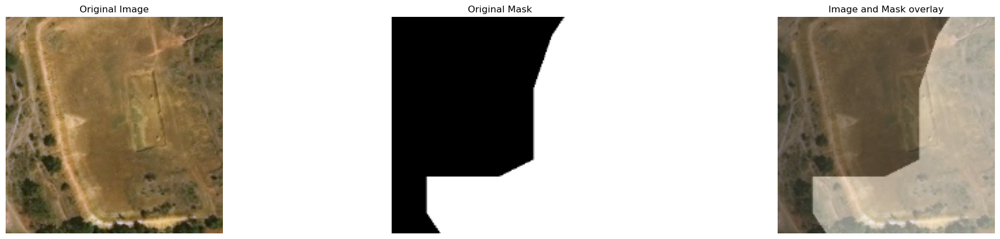

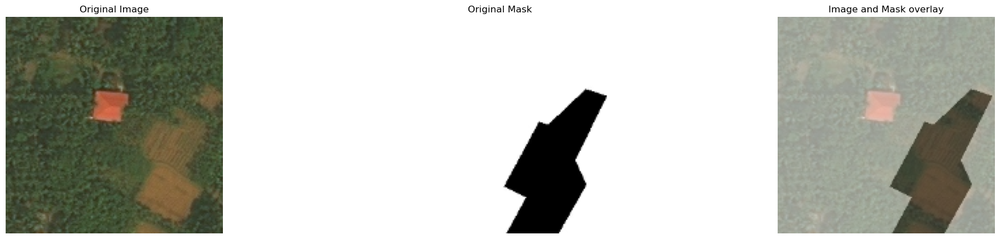

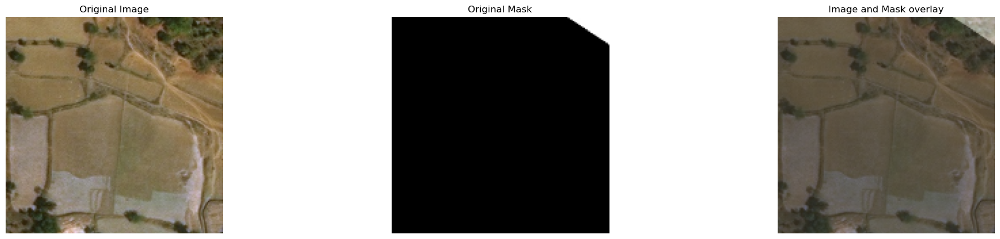

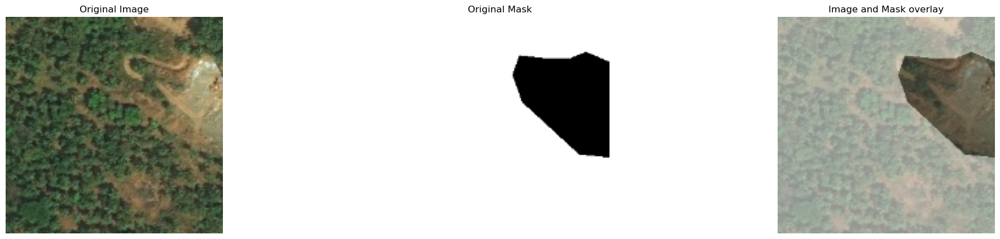

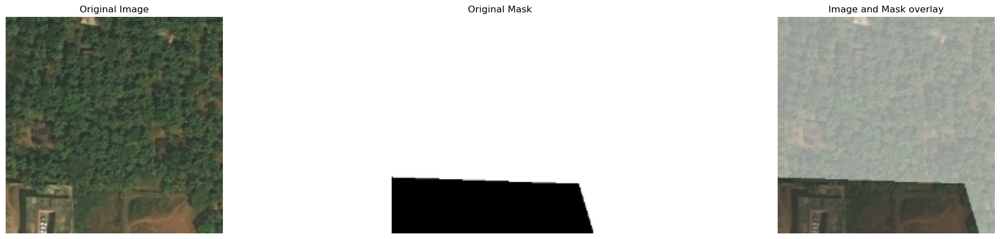

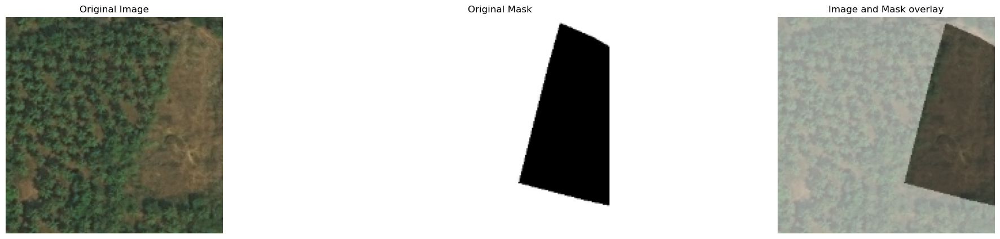

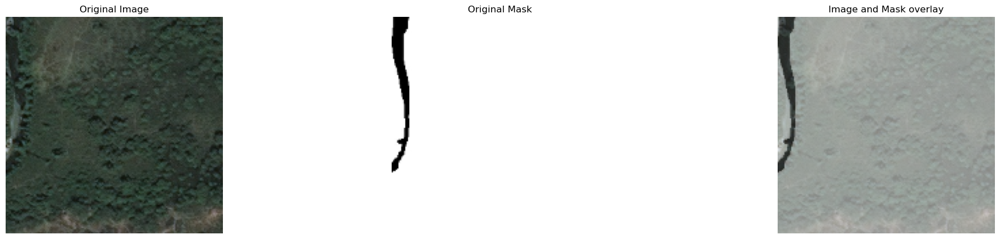

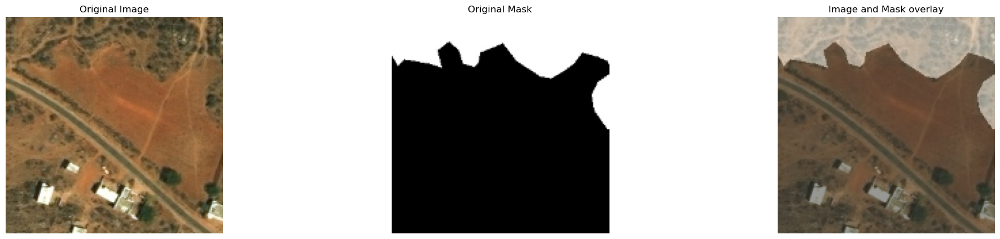

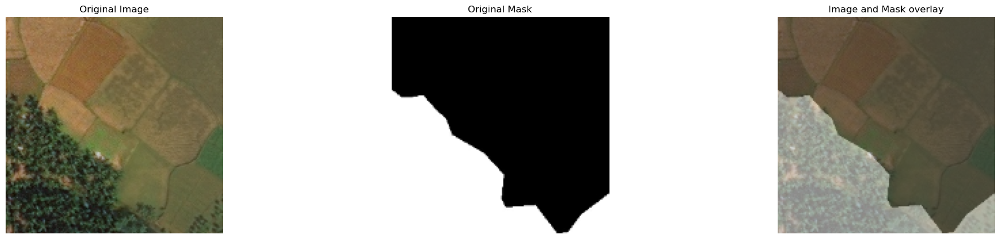

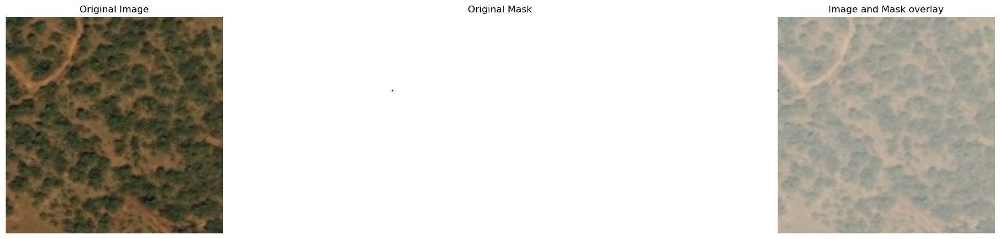

In [25]:
def show_images_and_masks(data : tfd.Dataset, n_images: int=10, FIGSIZE: tuple=(25, 5), model: tf.keras.Model=None):
    
    # Configuration
    if model is None:
        n_cols = 3
    else:
        n_cols = 5
    
    # Collect the data
    images, masks = next(iter(data))
    
    # Iterate over the data
    for n in range(n_images):
        
        # Plotting configuration
        plt.figure(figsize=FIGSIZE)
        
        # Plot the image
        plt.subplot(1, n_cols, 1)
        plt.title("Original Image")
        plt.imshow(images[n])
        plt.axis('off')
        
        # Plot the Mask
        plt.subplot(1, n_cols, 2)
        plt.title("Original Mask")
        plt.imshow(masks[n], cmap='gray')
        plt.axis('off')
        
        # Plot image and mask overlay
        plt.subplot(1, n_cols, 3)
        plt.title('Image and Mask overlay')
        plt.imshow(masks[n], alpha=0.8, cmap='binary_r')
        plt.imshow(images[n], alpha=0.5)
        plt.axis('off')
        
        # Model predictions
        if model is not None:
            pred_mask = model.predict(tf.expand_dims(images[n], axis=0))[0]
            pred_mask = pred_mask>=0.5
            plt.subplot(1, n_cols, 4)
            plt.title('Predicted Mask')
            plt.imshow(pred_mask, cmap='gray')
            plt.axis('off')
            
            plt.subplot(1, n_cols, 5)
            plt.title('Predicted Mask Overlay')
            plt.imshow(pred_mask, alpha=0.8, cmap='binary_r')
            plt.imshow(images[n], alpha=0.5)
            plt.axis('off')
    
        # Show final plot
        plt.show()

show_images_and_masks(data=train_ds)

In [26]:
class EncoderBlock(layers.Layer):
    
    def __init__(self, filters: int, max_pool: bool=True, rate=0.2, **kwargs) -> None:
        super().__init__(**kwargs)
        
        # Params
        self.rate = rate
        self.filters = filters
        self.max_pool = max_pool
        
        # Layers : Initialize the model layers that will be later called
        self.max_pooling = layers.MaxPool2D(pool_size=(2,2), strides=(2,2))
        self.conv1 = layers.Conv2D(
            filters=filters,
            kernel_size=3,
            strides=1,
            padding='same',
            activation='relu',
            kernel_initializer='he_normal'
        )
        self.conv2 = layers.Conv2D(
            filters=filters,
            kernel_size=3,
            strides=1,
            padding='same',
            activation='relu',
            kernel_initializer='he_normal'
        )
        self.drop = layers.Dropout(rate)
        self.bn = layers.BatchNormalization()
        
    def call(self, X, **kwargs):
        
        X = self.bn(X)
        X = self.conv1(X)
        X = self.drop(X)
        X = self.conv2(X)
        
        # Apply Max Pooling if required
        if self.max_pool:
            y = self.max_pooling(X)
            return y, X
        else:
            return X
    
    def get_config(self):
        config = super().get_config()
        config.update({
            'filters': self.filters,
            'max_pool': self.max_pool,
            'rate': self.rate
        })

    def __repr__(self):
        return f"{self.__class__.name}(F={self.filters}, Pooling={self.max_pool})"
    
class DecoderBlock(layers.Layer):
    
    def __init__(self, filters: int, rate: float = 0.2, **kwargs):
        super().__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        
        # Initialize the model layers
        self.convT = layers.Conv2DTranspose(
            filters = filters,
            kernel_size = 3,
            strides = 2,
            padding = 'same',
            activation = 'relu',
            kernel_initializer = 'he_normal'
        )
        self.bn = layers.BatchNormalization()
        self.net = EncoderBlock(filters = filters, rate = rate, max_pool = False)
        
    def call(self, inputs, **kwargs):
        
        # Get both the inputs
        X, skip_X = inputs
        
        # Up-sample the skip connection
        X = self.bn(X)
        X = self.convT(X)
        
        # Concatenate both inputs
        X = layers.Concatenate(axis=-1)([X, skip_X])
        X = self.net(X)
        
        return X

    def get_config(self):
        config = super().get_config()
        config.update({
            'filters': self.filters,
            'rate': self.rate,
        })
        return config

    def __repr__(self):
        return f"{self.__class__.__name__}(F={self.filters}, rate={self.rate})"

In [27]:
# Input Layer
input_layer = layers.Input(shape=(IMAGE_SIZE), name="InputLayer")

# The encoder network
pool1, encoder1 = EncoderBlock(FILTERS,   max_pool=True, rate=0.1, name="EncoderLayer1")(input_layer)
pool2, encoder2 = EncoderBlock(FILTERS*2, max_pool=True, rate=0.1, name="EncoderLayer2")(pool1)
pool3, encoder3 = EncoderBlock(FILTERS*4, max_pool=True, rate=0.2, name="EncoderLayer3")(pool2)
pool4, encoder4 = EncoderBlock(FILTERS*8, max_pool=True, rate=0.2, name="EncoderLayer4")(pool3)

# The encoder encoding
encoding = EncoderBlock(FILTERS*16, max_pool=False, rate=0.3, name="EncodingSpace")(pool4)

# The decoder network
decoder4 = DecoderBlock(FILTERS*8, rate=0.2, name="DecoderLayer1")([encoding, encoder4])
decoder3 = DecoderBlock(FILTERS*4, rate=0.2, name="DecoderLayer2")([decoder4, encoder3])
decoder2 = DecoderBlock(FILTERS*2, rate=0.1, name="DecoderLayer3")([decoder3, encoder2])
decoder1 = DecoderBlock(FILTERS,  rate=0.1, name="DecoderLayer4")([decoder2, encoder1])
        
# Final output layer.
final_conv = layers.Conv2D(
    filters = 1, 
    kernel_size = 1, 
    strides=1, 
    padding='same', 
    activation='sigmoid', 
    name="OutputMap"
)(decoder1)

# Unet Model
unet_model = keras.Model(
    inputs = input_layer,
    outputs = final_conv,
    name = "UNetModel"
)
# Model Summary
unet_model.summary()

Model: "UNetModel"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 160, 160, 3)]        0         []                            
                                                                                                  
 EncoderLayer1 (EncoderBloc  ((None, 80, 80, 32),         10156     ['InputLayer[0][0]']          
 k)                           (None, 160, 160, 32))                                               
                                                                                                  
 EncoderLayer2 (EncoderBloc  ((None, 40, 40, 64),         55552     ['EncoderLayer1[0][0]']       
 k)                           (None, 80, 80, 64))                                                 
                                                                                          

In [31]:
class ShowProgress(callbacks.Callback):
    """A callback that displays the original image, the original mask, 
    the predicted mask, and the Grad-CAM visualization for a sample image 
    after each epoch of training.
    
    Args:
        data (tf.data.Dataset): A dataset of image-mask pairs.
        layer_name (str): The name of the layer to use for Grad-CAM.
        cmap (str, optional): The colormap to use for displaying the masks. 
            Defaults to 'gray'.
        output_dir (str, optional): The directory to save the output images. 
            If None, the images will not be saved. Defaults to None.
        num_images (int, optional): The number of images to display. 
            Defaults to 1.
        file_format (str, optional): The format to save the output images in. 
            Defaults to 'png'.
    """
    def __init__(self, data: tf.data.Dataset, layer_name: str, cmap: str = 'gray', 
                 output_dir: str = None, num_images: int = 1, file_format: str = 'png',
                 **kwargs):
        super().__init__(**kwargs)
        
        # Validate inputs
        if not isinstance(data, tf.data.Dataset):
            raise ValueError('The `data` parameter must be a tf.data.Dataset.')
        if not isinstance(layer_name, str):
            raise ValueError('The `layer_name` parameter must be a string.')
        if not isinstance(num_images, int) or num_images < 1:
            raise ValueError('The `num_images` parameter must be an integer greater than 0.')
        if file_format not in ['png', 'jpg', 'pdf']:
            raise ValueError('The `file_format` parameter must be "png", "jpg", or "pdf".')
        
        self.data = data
        self.layer_name = layer_name
        self.cmap = cmap
        self.output_dir = output_dir
        self.num_images = num_images
        self.file_format = file_format
    
    def on_epoch_end(self, epoch, logs=None):
        """Displays the original image, the original mask, the predicted mask, 
        and the Grad-CAM visualization for a sample image.
        """
        # Plotting configuration
        plt.figure(figsize=(25, 8 * self.num_images))
        
        for i in range(self.num_images):
            # Get Data 
            images, masks = next(iter(self.data))
            images = images.numpy()
            masks = masks.numpy()

            # Select image
            index = np.random.randint(len(images))
            image, mask = images[index], masks[index]

            # Make Prediction
            pred_mask = self.model.predict(np.expand_dims(image, axis=0))[0]

            # Initialize Grad CAM
            cam = GradCAM().explain(
                class_index=0,
                model=self.model,
                validation_data=(np.expand_dims(image, axis=0), mask),
                layer_name=self.layer_name
            )

            # Show Image
            plt.subplot(1, 4, 1)
            plt.title("Original Image")
            plt.imshow(image)
            plt.axis('off')

            # Show Mask
            plt.subplot(1, 4, 2)
            plt.title("Original Mask")
            plt.imshow(mask, cmap=self.cmap)
            plt.axis('off')

            # Show Model Pred
            plt.subplot(1, 4, 3)
            plt.title("Predicted Mask")
            plt.imshow(pred_mask, cmap=self.cmap)
            plt.axis('off')

            # Show Grad CAM
            plt.subplot(1, 4, 4)
            plt.title("Grad CAM")
            plt.imshow(cam)
            plt.axis('off')

            # Save figure
            if self.output_dir is not None:
                path = os.path.join(os.curdir, self.output_dir)
                plt.savefig(f'Epoch({epoch+1})-Viz.{self.file_format}')

            # Show Final plot
            plt.show()

In [32]:
# Obtain data for GradCAM.
test_images, test_masks = next(iter(test_ds))

# Adding GradCAM to call backs

CALLBACKS = [
    callbacks.EarlyStopping(
        patience = 10, 
        restore_best_weights = True),
#     callbacks.ModelCheckpoint(
#         MODEL_NAME + '.h5', 
#         save_best_only = True),
    ShowProgress(
        data = valid_ds,
        layer_name = "DecoderLayer4"
    )
]

In [33]:
def dice_coeff(y_true: tf.Tensor, y_pred: tf.Tensor, smooth: float=1.0) -> tf.Tensor:
    
    """Compute the Dice coefficient between predicted and true masks.

    Args:
        y_true (tf.Tensor): True masks. Shape (batch_size, height, width, num_channels).
        y_pred (tf.Tensor): Predicted masks. Shape (batch_size, height, width, num_channels).
        smooth (float): Smoothing factor to avoid division by zero.

    Returns:
        tf.Tensor: Dice coefficient score.

    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1, 2, 3])
    union = tf.reduce_sum(y_true, axis=[1, 2, 3]) + tf.reduce_sum(y_pred, axis=[1, 2, 3])
    dice = tf.reduce_mean((2.0 * intersection + smooth) / (union + smooth), axis=0)

    return tf.cast(dice, tf.float32)


In [34]:
# Pixel Accuracy 
pixel_acc = metrics.Accuracy(name="PixelAccuracy")

# Mean Intersection Over Union
mean_iou = metrics.MeanIoU(num_classes=2, name="MeanIoU")

# Exponential learning rate decay
initial_learning_rate = BASE_LR
decay_steps = 500
decay_rate = 0.96

lr_schedule = ExponentialDecay(
    initial_learning_rate,
    decay_steps,
    decay_rate,
    staircase=True
)

optimizer = optimizers.Adam(learning_rate=lr_schedule)

# Compile Model
unet_model.compile(
    loss = 'binary_crossentropy',
    optimizer = optimizer,
    metrics = [
        pixel_acc,
        mean_iou,
        dice_coeff
    ]
)

Epoch 1/10


1/1 [==============================] - 1s 890ms/step loss: 0.5602 - PixelAccuracy: 1.1355e-06 - MeanIoU: 0.2006 - dice_coeff: 0.61


/home/jinda/anaconda3/lib/python3.11/site-packages/tf_explain/utils/display.py:112: RuntimeWarning: invalid value encountered in divide
  heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())


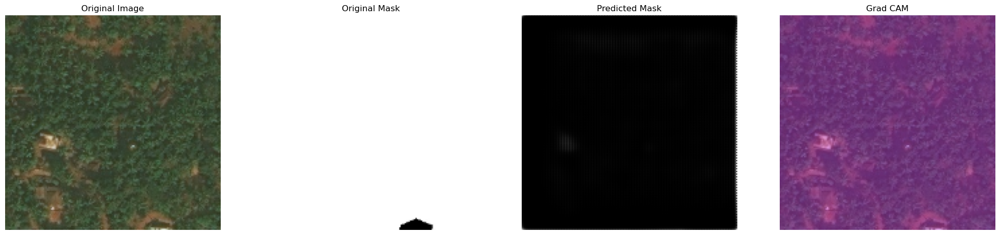

129/129 [==============================] - 36s 277ms/step - loss: 0.5602 - PixelAccuracy: 1.1355e-06 - MeanIoU: 0.2006 - dice_coeff: 0.6178 - val_loss: 3.8763 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2078 - val_dice_coeff: 0.0117
Epoch 2/10
1/1 [==============================] - 0s 38ms/step- loss: 0.4896 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2003 - dice_coeff: 0.64


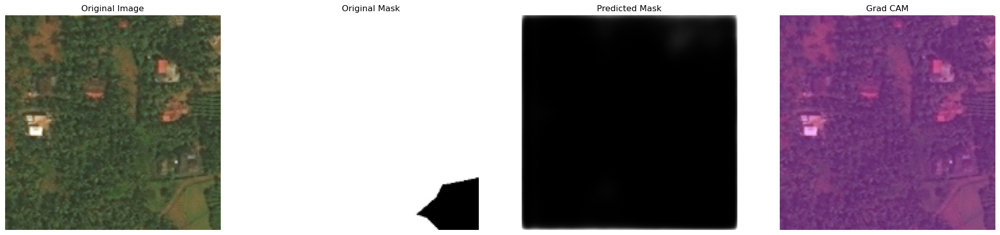

129/129 [==============================] - 32s 245ms/step - loss: 0.4896 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2003 - dice_coeff: 0.6450 - val_loss: 2.2921 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.1997 - val_dice_coeff: 0.3611
Epoch 3/10
1/1 [==============================] - 0s 27ms/step- loss: 0.4658 - PixelAccuracy: 3.7851e-08 - MeanIoU: 0.2005 - dice_coeff: 0.65


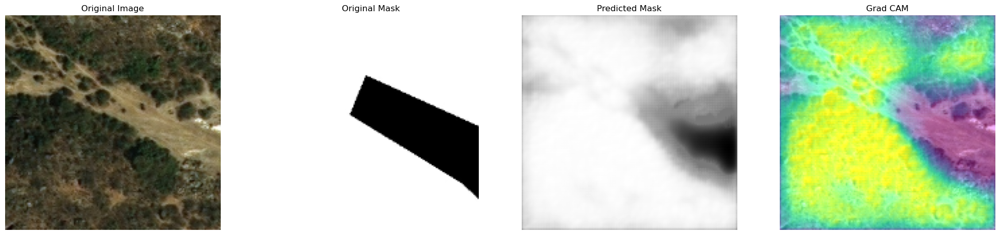

129/129 [==============================] - 32s 247ms/step - loss: 0.4658 - PixelAccuracy: 3.7851e-08 - MeanIoU: 0.2005 - dice_coeff: 0.6539 - val_loss: 0.8862 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2004 - val_dice_coeff: 0.5377
Epoch 4/10
1/1 [==============================] - 0s 32ms/step- loss: 0.4536 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.1984 - dice_coeff: 0.66


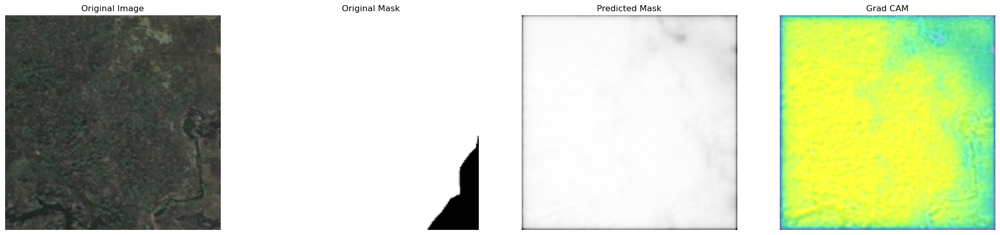

129/129 [==============================] - 32s 249ms/step - loss: 0.4536 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.1984 - dice_coeff: 0.6609 - val_loss: 0.4956 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.1921 - val_dice_coeff: 0.7286
Epoch 5/10
1/1 [==============================] - 0s 51ms/step- loss: 0.4483 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2002 - dice_coeff: 0.66


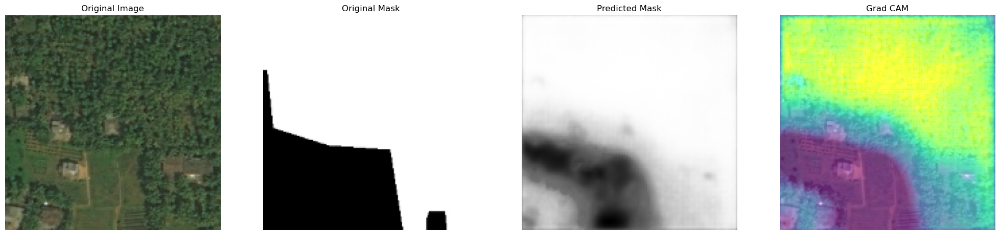

129/129 [==============================] - 32s 246ms/step - loss: 0.4483 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2002 - dice_coeff: 0.6638 - val_loss: 0.4689 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2031 - val_dice_coeff: 0.6969
Epoch 6/10
1/1 [==============================] - 0s 21ms/step- loss: 0.4443 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2009 - dice_coeff: 0.66


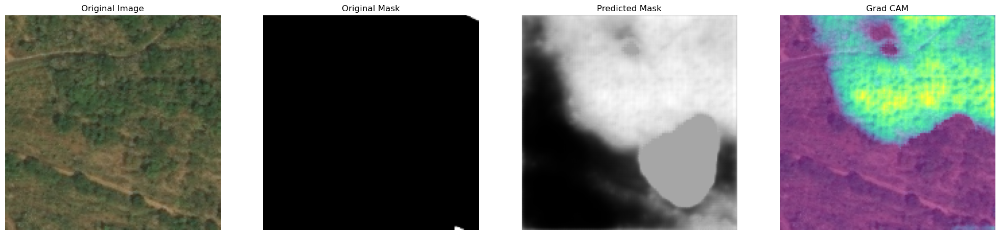

129/129 [==============================] - 32s 248ms/step - loss: 0.4443 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2009 - dice_coeff: 0.6626 - val_loss: 0.5853 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2001 - val_dice_coeff: 0.6557
Epoch 7/10
1/1 [==============================] - 0s 36ms/step- loss: 0.4380 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2013 - dice_coeff: 0.66


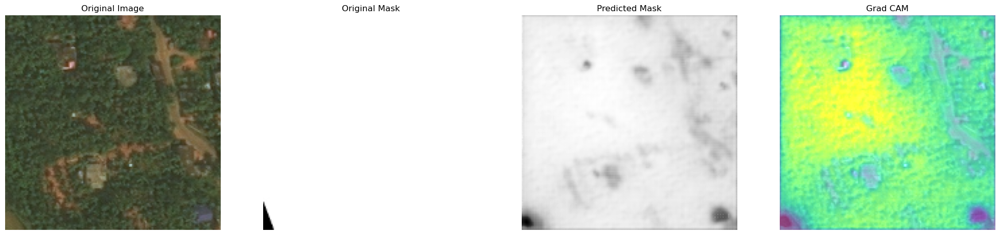

129/129 [==============================] - 32s 248ms/step - loss: 0.4380 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2013 - dice_coeff: 0.6674 - val_loss: 0.5036 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2036 - val_dice_coeff: 0.6645
Epoch 8/10
1/1 [==============================] - 0s 27ms/step- loss: 0.4365 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2012 - dice_coeff: 0.66


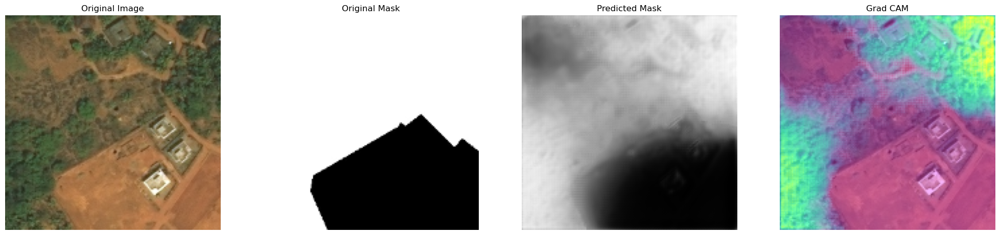

129/129 [==============================] - 32s 246ms/step - loss: 0.4365 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2012 - dice_coeff: 0.6656 - val_loss: 0.4520 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.2011 - val_dice_coeff: 0.6768
Epoch 9/10
1/1 [==============================] - 0s 37ms/step- loss: 0.4375 - PixelAccuracy: 9.4628e-09 - MeanIoU: 0.2002 - dice_coeff: 0.66


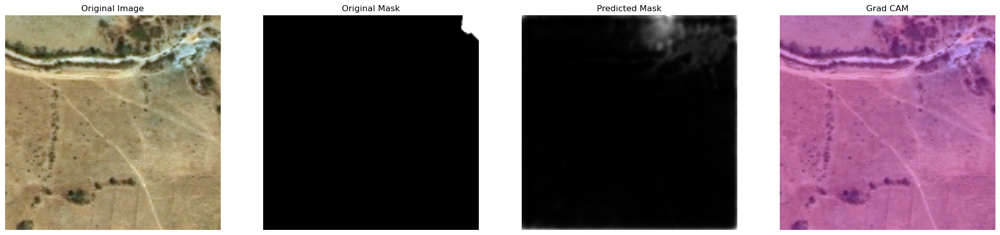

129/129 [==============================] - 32s 248ms/step - loss: 0.4375 - PixelAccuracy: 9.4628e-09 - MeanIoU: 0.2002 - dice_coeff: 0.6668 - val_loss: 0.5232 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.1847 - val_dice_coeff: 0.6863
Epoch 10/10
1/1 [==============================] - 0s 25ms/step- loss: 0.4268 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2007 - dice_coeff: 0.67


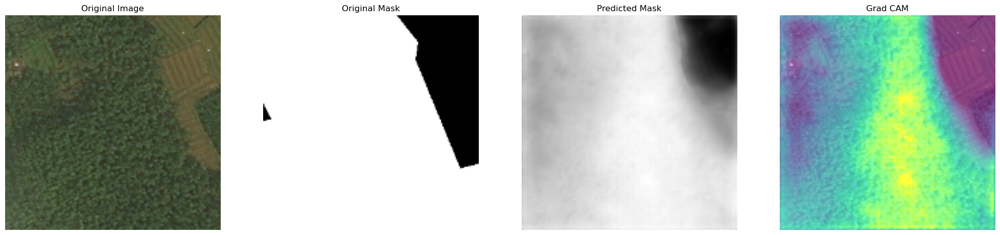

129/129 [==============================] - 32s 246ms/step - loss: 0.4268 - PixelAccuracy: 0.0000e+00 - MeanIoU: 0.2007 - dice_coeff: 0.6733 - val_loss: 0.4019 - val_PixelAccuracy: 0.0000e+00 - val_MeanIoU: 0.1877 - val_dice_coeff: 0.6908


In [37]:
unet_model_history = unet_model.fit(
    train_ds,
    validation_data = valid_ds,
    epochs = EPOCHS,
    callbacks = CALLBACKS,
    batch_size = BATCH_SIZE,
)


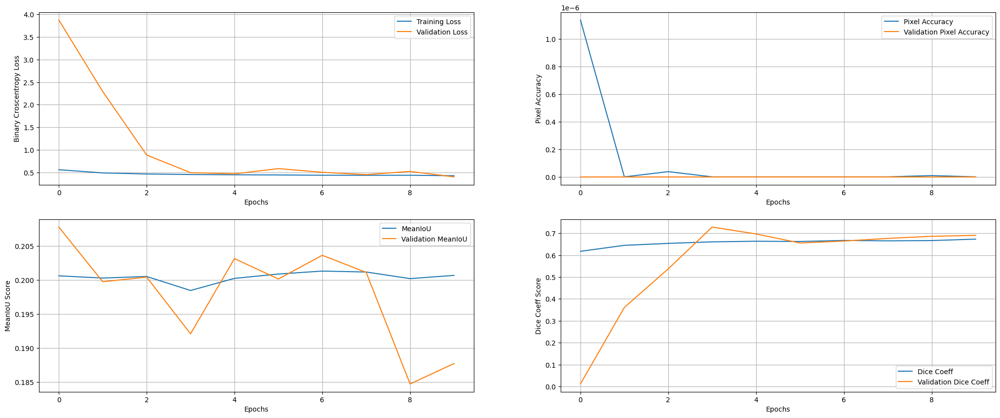

In [40]:
history = unet_model_history.history
plt.figure(figsize=(25,10))

plt.subplot(2,2,1)
plt.plot(history['loss'], label='Training Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Binary Croscentropy Loss')
plt.legend()
plt.grid()

plt.subplot(2,2,2)
plt.plot(history['PixelAccuracy'], label='Pixel Accuracy')
plt.plot(history['val_PixelAccuracy'], label='Validation Pixel Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Pixel Accuracy')
plt.legend()
plt.grid()

plt.subplot(2,2,3)
plt.plot(history['MeanIoU'], label='MeanIoU')
plt.plot(history['val_MeanIoU'], label='Validation MeanIoU')
plt.xlabel('Epochs')
plt.ylabel('MeanIoU Score')
plt.legend()
plt.grid()

plt.subplot(2,2,4)
plt.plot(history['dice_coeff'], label='Dice Coeff')
plt.plot(history['val_dice_coeff'], label='Validation Dice Coeff')
plt.xlabel('Epochs')
plt.ylabel('Dice Coeff Score')
plt.legend()
plt.grid()
plt.show()

# Model Predictions

1/1 [==============================] - 0s 23ms/step


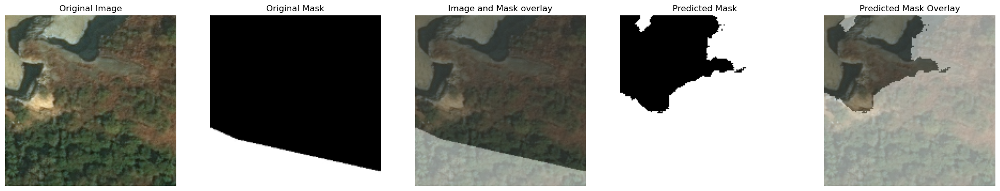

1/1 [==============================] - 0s 36ms/step


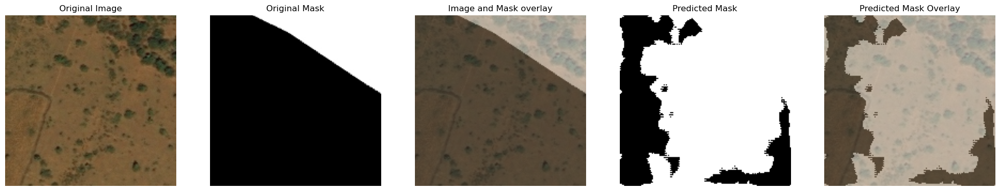

1/1 [==============================] - 0s 28ms/step


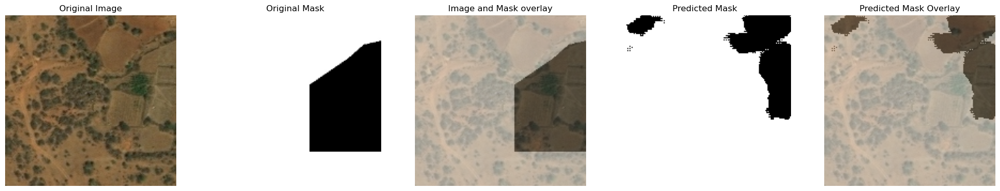

1/1 [==============================] - 0s 29ms/step


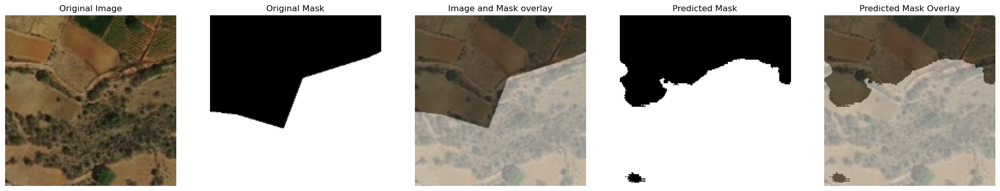

1/1 [==============================] - 0s 21ms/step


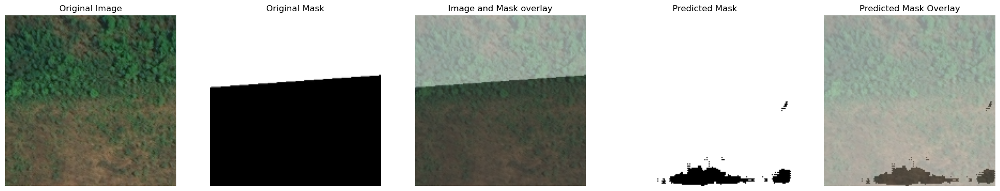

1/1 [==============================] - 0s 29ms/step


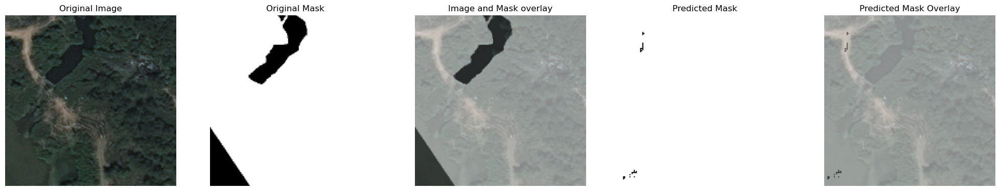

1/1 [==============================] - 0s 21ms/step


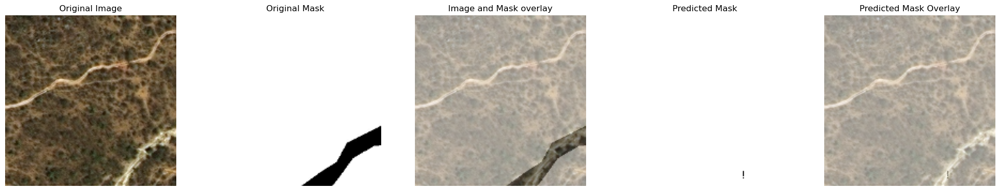

1/1 [==============================] - 0s 28ms/step


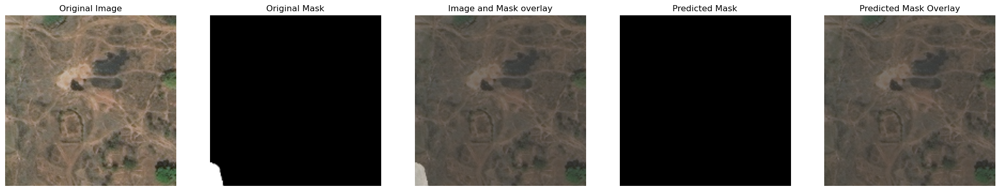

1/1 [==============================] - 0s 54ms/step


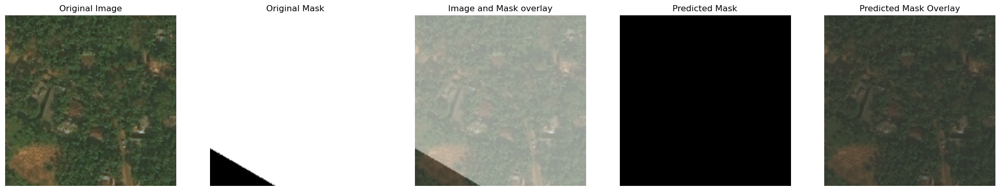

1/1 [==============================] - 0s 28ms/step


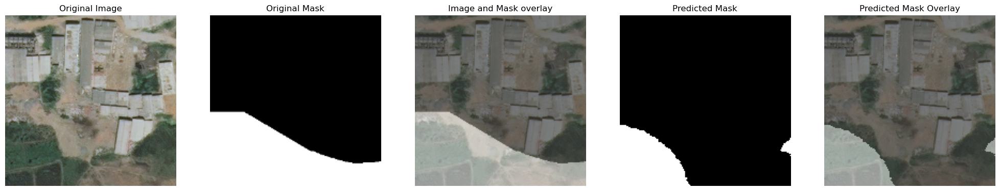

In [41]:
show_images_and_masks(data=train_ds, model=unet_model)

1/1 [==============================] - 0s 32ms/step


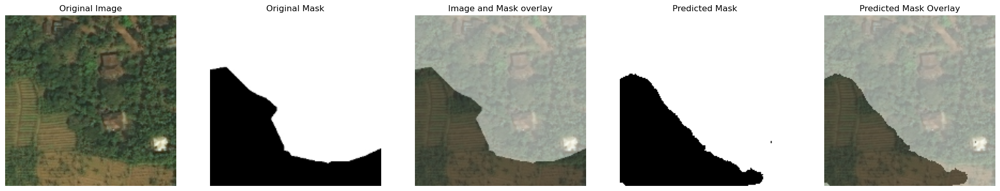

1/1 [==============================] - 0s 30ms/step


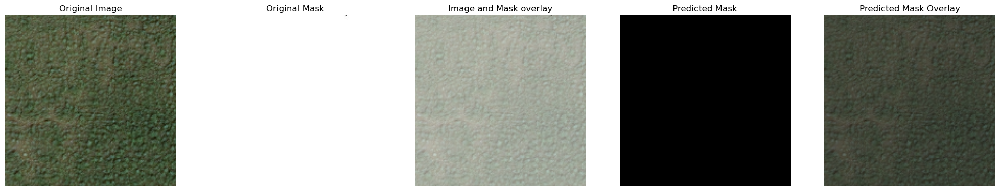

1/1 [==============================] - 0s 25ms/step


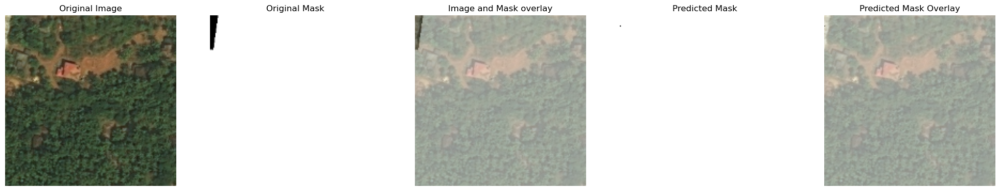

1/1 [==============================] - 0s 21ms/step


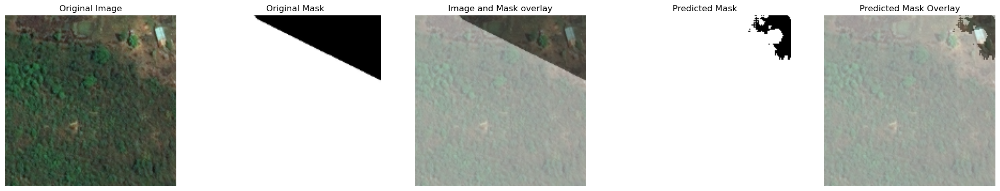

1/1 [==============================] - 0s 22ms/step


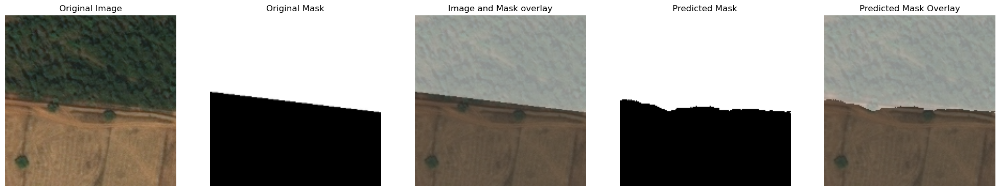

1/1 [==============================] - 0s 34ms/step


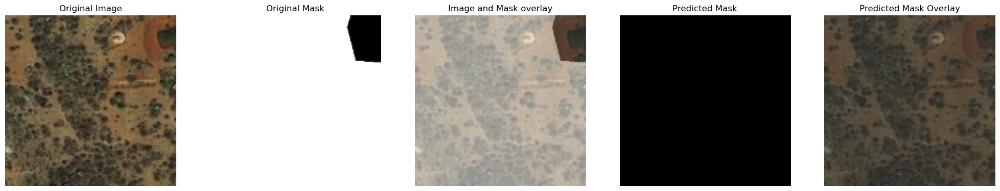

1/1 [==============================] - 0s 23ms/step


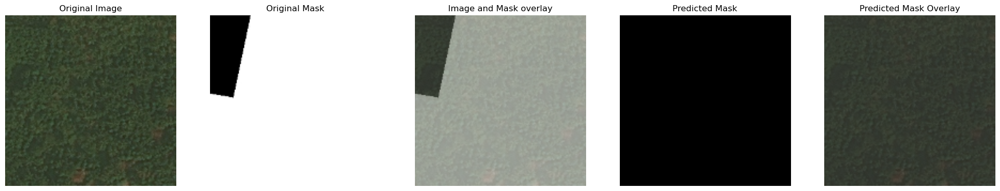

1/1 [==============================] - 0s 29ms/step


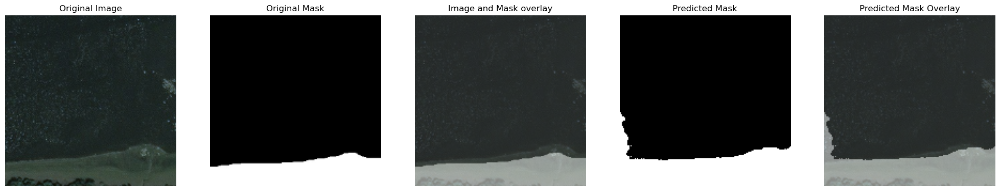

1/1 [==============================] - 0s 21ms/step


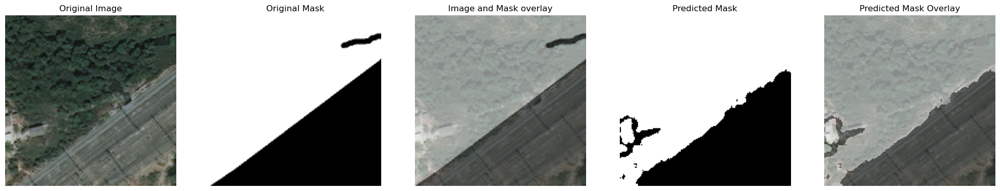

1/1 [==============================] - 0s 19ms/step


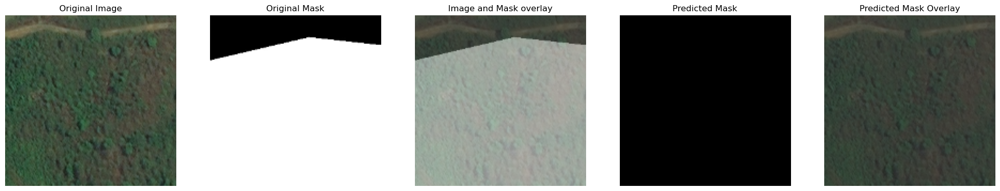

In [42]:
show_images_and_masks(data=valid_ds, model=unet_model)

1/1 [==============================] - 0s 22ms/step


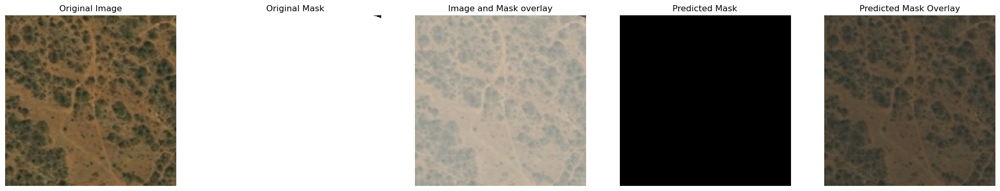

1/1 [==============================] - 0s 59ms/step


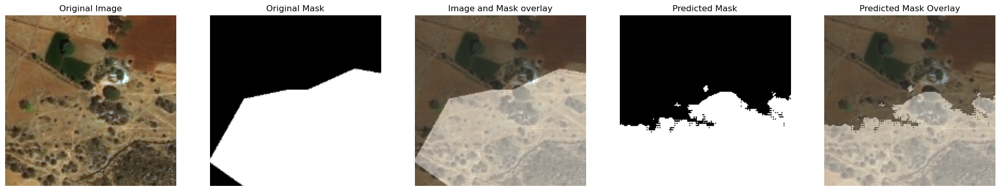

1/1 [==============================] - 0s 36ms/step


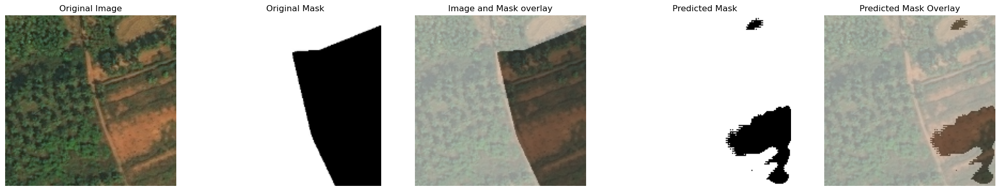

1/1 [==============================] - 0s 31ms/step


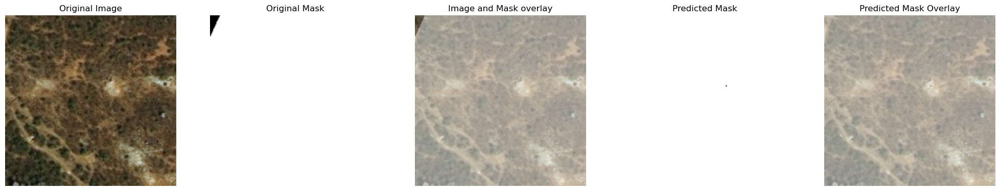

1/1 [==============================] - 0s 22ms/step


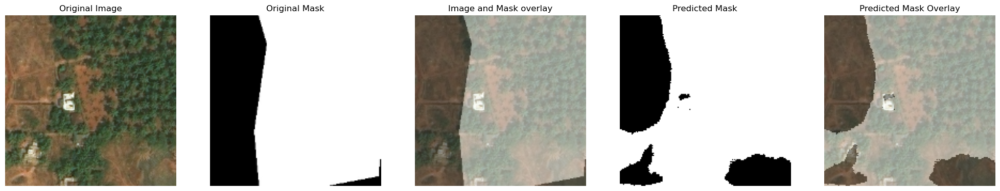

1/1 [==============================] - 0s 27ms/step


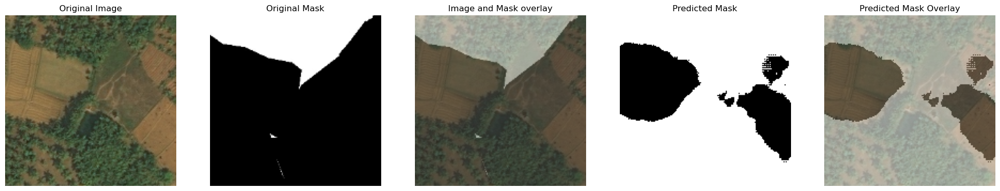

1/1 [==============================] - 0s 27ms/step


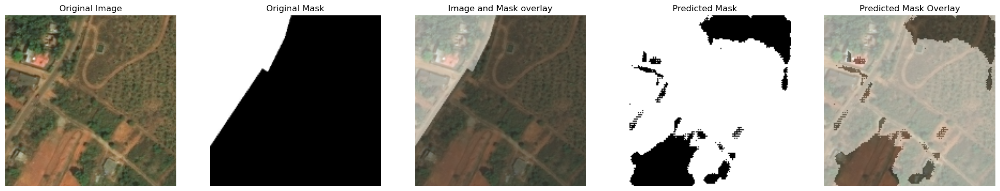

1/1 [==============================] - 0s 27ms/step


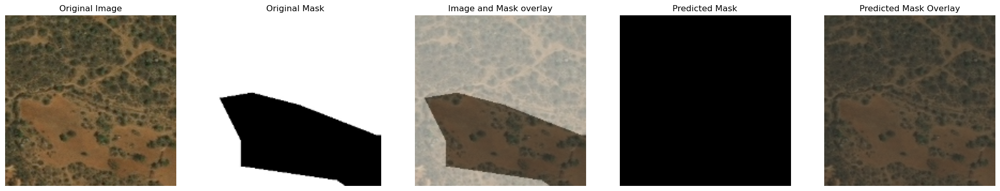

1/1 [==============================] - 0s 21ms/step


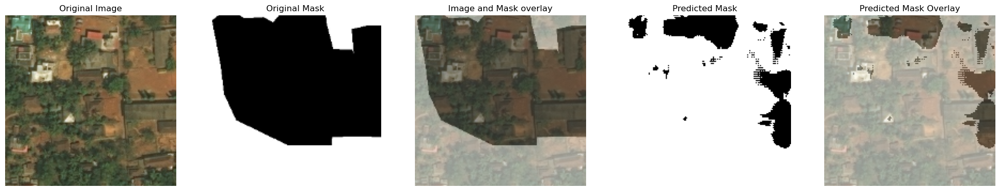

1/1 [==============================] - 0s 25ms/step


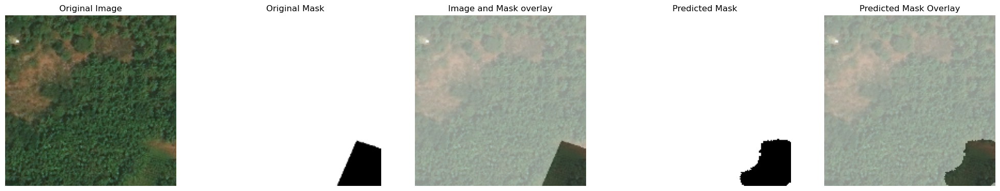

In [43]:
show_images_and_masks(data=test_ds, model=unet_model)